# GANs for generating celebrity faces
 Generative Adversarial Networks (GANs) have revolutionized the field of image generation, offering the ability to generate highly realistic images. This has seen particular application in generating celebrity faces, an area popularized by a dataset known as CelebA, which contains over 200,000 celebrity images. These images can be utilized to train a GAN, the end result being a model capable of generating new, synthetic images of celebrity-like faces.

This application has several potential uses. It can serve as a tool for researchers studying facial recognition technology, offering a dataset of high-quality, diverse images. For artists or graphic designers, it can provide a source of inspiration or material for digital artwork. In the entertainment industry, it can aid in the creation of virtual characters for films, video games, or virtual reality experiences.

The quality and realism of the images generated is highly dependent on the architecture of the GAN and the training process. It often requires a lot of computational power and careful fine-tuning of parameters. However, with the right resources and approach, GANs can generate faces that are almost indistinguishable from real human faces.

In [ ]:
from google.colab import drive
drive.mount("/content/drive")

Mounted at /content/drive


### Importing necessary libraries

This is a step where we load or import the necessary modules or libraries into our Python environment. These libraries provide various functionalities and features which we utilize in our code

In [ ]:
# Importing necessary libraries
from __future__ import print_function
#%matplotlib inline
import argparse
import os
import random
import torch
import torch.nn as nn
import torch.nn.parallel
import torch.backends.cudnn as cudnn
import torch.optim as optim
import torch.utils.data
import torchvision.datasets as dset
import torchvision.transforms as transforms
import torchvision.utils as vutils
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.animation as animation
from IPython.display import HTML
%matplotlib inline

# Set random seed for reproducibility
manualSeed = 999
#manualSeed = random.randint(1, 10000) # use if you want new results
random.seed(manualSeed)
torch.manual_seed(manualSeed)

### Extracting and Preparing the CelebA Dataset

This code segment is focused on setting up the CelebA dataset for training a GAN model. The CelebA dataset, which contains over 200,000 annotated images of celebrities, is copied from a specified Google Drive location to a newly created directory, celeba_gan. Subsequently, the dataset is extracted from its ZIP file format, readying it for model training.

- Get the data zip file from this [link](https://drive.google.com/file/d/1it5tKyeljnG5O5_FKvtSZiMIbBAcQp8Y/view?usp=sharing).

In [ ]:
!mkdir celeba_gan
!cp -r img_align_celeba.zip
!unzip -qq celeba_gan/img_align_celeba.zip -d celeba_gan


### Initialization of GAN Hyperparameters
n this section, we set up various hyperparameters that control the behavior of the Generative Adversarial Network's components - the generator and discriminator. The parameters include elements such as learning rates, batch size, number of training epochs, latent vector size, and others, all of which significantly influence the model's performance. These hyperparameters are initialized in preparation for the construction and training of the GAN model, and their values can be tuned to optimize the model's effectiveness in generating synthetic chest X-ray images.

In [ ]:
# Number of workers for dataloader
workers = 4

# Batch size during training
batch_size = 128

# Spatial size of training images. All images will be resized to this
# size using a transformer.
image_size = 64

# Number of channels in the training images. For color images this is 3
nc = 3

# Size of z latent vector (i.e. size of generator input)
nz = 100

# Size of feature maps in generator
ngf = 64

# Size of feature maps in discriminator
ndf = 64

# Number of training epochs
num_epochs = 5

# Learning rate for optimizers
lr = 0.0002

# Beta1 hyperparam for Adam optimizers
beta1 = 0.5

# Number of GPUs available. Use 0 for CPU mode.
ngpu = 1

### Image Dataset Preparation and DataLoader Creation
This section pertains to the preparation of the image dataset and the creation of a DataLoader to feed the images into the GAN during training. The function create_dataloader is designed to load images from a specified directory and perform a series of transformations on them, including resizing, center cropping, tensor conversion, and normalization. These transformations standardize the input data and enable easier processing by the model. The DataLoader created by this function batches the processed images, shuffles them for randomness, and is ready to be used in subsequent stages of the GAN training process.

In [ ]:
# Create the dataset
# Give the path to your data here

dataroot = "/content/celeba_gan"

def create_dataloader(dataroot, image_size, batch_size, workers):
    """
    This function creates a DataLoader for an ImageFolder dataset.

    The images are transformed by:
    1. Resizing to the specified size.
    2. Center cropping to the specified size.
    3. Converting to tensor.
    4. Normalizing to have a mean of 0.5 and a standard deviation of 0.5.

    Args:
    dataroot (str): Path to the directory with the images.
    image_size (int): Size for the image resizing and cropping.
    batch_size (int): Number of samples per batch to load.
    workers (int): Number of subprocesses to use for data loading.

    Returns:
    DataLoader: DataLoader for the ImageFolder dataset with the specified transformations.
    """
    dataset = dset.ImageFolder(root=dataroot,
                               transform=transforms.Compose([
                                   transforms.Resize(image_size),
                                   transforms.CenterCrop(image_size),
                                   transforms.ToTensor(),
                                   transforms.Normalize((0.5), (0.5)),
                               ]))

    dataloader = torch.utils.data.DataLoader(dataset, batch_size=batch_size,
                                             shuffle=True, num_workers=workers)

    return dataloader

dataloader = create_dataloader(dataroot, image_size, batch_size, workers)




/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py:557: UserWarning: This DataLoader will create 4 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  warnings.warn(_create_warning_msg(


### Device configuration for Pytorch
The device configuration step is where we set up the computational device that PyTorch will use for calculations. If a GPU (Graphical Processing Unit) is available, PyTorch will use it for its computations, making the process significantly faster. If a GPU isn't available, it will default to using the CPU (Central Processing Unit).

In [ ]:
# Decide which device we want to run on
device = torch.device("cuda:0" if (torch.cuda.is_available() and ngpu > 0) else "cpu")


### Visualization of Training Images

This function, plot_images, is designed to visualize a batch of images from the provided dataloader. It first retrieves a batch of images, moves them to the designated device, and then constructs a grid of images for easier visualization. This grid is then plotted using matplotlib's imshow function. The visualization of training images can be useful for understanding the data the GAN will be trained on, and checking the effectiveness of any pre-processing steps.

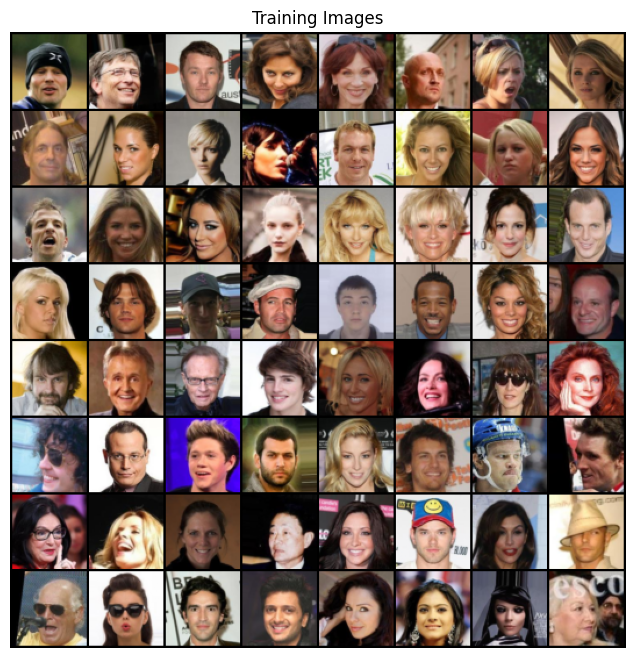

In [ ]:
def plot_images(dataloader, device):
    """
    This function plots the first batch of images from the dataloader.

    The images are retrieved from the dataloader, moved to the specified device,
    and a grid of images is created and plotted.

    Args:
    dataloader (DataLoader): DataLoader for the dataset.
    device (torch.device): Device where the tensors will be moved.

    Returns:
    None
    """

    # Get a batch of training images
    real_batch = next(iter(dataloader))

    plt.figure(figsize=(8,8))
    plt.axis("off")
    plt.title("Training Images")

    # Create the grid of images and move it to the CPU
    grid = vutils.make_grid(real_batch[0].to(device)[:64], padding=2, normalize=True).cpu()

    # Transpose the tensor to match the image dimensions and convert it to a numpy array
    grid = np.transpose(grid, (1,2,0))

    # Plot the images
    plt.imshow(grid)

    plt.show()

plot_images(dataloader, device)


### Initializing Weights of Generator and Discriminator Networks
This function, weights_init, is utilized to initialize the weights of our Generator and Discriminator networks in the GANs setup. It takes a PyTorch model as input and initializes the weights based on the type of each layer in the model. For convolutional layers, weights are initialized from a normal distribution with mean 0.0 and standard deviation 0.02. For batch normalization layers, the weights are initialized from a normal distribution with mean 1.0 and standard deviation 0.02, and the biases are initialized to 0.

In [ ]:
# Custom weights initialization called on netG and netD
def weights_init(m):
    """
    This function initializes the weights of a PyTorch model.

    The initialization is done based on the type of the layer:
    1. If the layer is a convolutional layer ('Conv'), its weights are initialized from a normal distribution
       with mean 0.0 and standard deviation 0.02.
    2. If the layer is a batch normalization layer ('BatchNorm'), its weights are initialized from a normal
       distribution with mean 1.0 and standard deviation 0.02, and its biases are initialized to 0.

    Args:
    m (torch.nn.Module): The model or layer to initialize.

    Returns:
    None
    """
    import torch.nn as nn
    classname = m.__class__.__name__

    if classname.find('Conv') != -1:
        nn.init.normal_(m.weight.data, 0.0, 0.02)
    elif classname.find('BatchNorm') != -1:
        nn.init.normal_(m.weight.data, 1.0, 0.02)
        nn.init.constant_(m.bias.data, 0)


### Designing the Generator for GAN

The Generator class, part of a Deep Convolutional Generative Adversarial Network (DCGAN), is a neural network that generates synthetic data resembling a distribution of real data, specifically images. It's built using a series of Transposed Convolutional layers with Batch Normalization and ReLU activations, culminating with a Tanh activation, gradually scaling the input latent vector 'z' into the dimension of the desired output image. Its primary role in the GAN setup is to create realistic data capable of deceiving the discriminator network into classifying it as real.

In [ ]:
class Generator(nn.Module):
    """
    Generator Module for a Generative Adversarial Network (GAN).

    This class implements a generator model that takes a latent vector (z) as input and outputs a fake sample.
    The architecture of the model is a series of Transposed Convolutional layers with Batch Normalization and ReLU
    activations, followed by a Tanh activation at the output. This structure is typically used in a Deep
    Convolutional GAN (DCGAN).

    The sequence of layers and their corresponding output sizes are as follows:
    1. Transposed Convolution: input is z, output size (ngf*8) x 4 x 4.
    2. Transposed Convolution: input is (ngf*8) x 4 x 4, output size (ngf*4) x 8 x 8.
    3. Transposed Convolution: input is (ngf*4) x 8 x 8, output size (ngf*2) x 16 x 16.
    4. Transposed Convolution: input is (ngf*2) x 16 x 16, output size (ngf) x 32 x 32.
    5. Transposed Convolution: input is (ngf) x 32 x 32, output size (nc) x 64 x 64.

    The output of the generator is an image with pixel values in the range [-1, 1] due to the Tanh activation.

    Attributes:
    ngpu (int): Number of GPUs available. If this is 0, the code will run in CPU mode.
    main (torch.nn.Module): The main network architecture of the generator.

    Args:
    ngpu (int): Number of GPUs available.
    """

    def __init__(self, ngpu):
        super(Generator, self).__init__()
        self.ngpu = ngpu
        self.main = nn.Sequential(
            # input is Z, going into a convolution
            nn.ConvTranspose2d(nz, ngf * 8, 4, 1, 0, bias=False),
            nn.BatchNorm2d(ngf * 8),
            nn.ReLU(True),
            # state size. (ngf*8) x 4 x 4
            nn.ConvTranspose2d(ngf * 8, ngf * 4, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf * 4),
            nn.ReLU(True),
            # state size. (ngf*4) x 8 x 8
            nn.ConvTranspose2d( ngf * 4, ngf * 2, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf * 2),
            nn.ReLU(True),
            # state size. (ngf*2) x 16 x 16
            nn.ConvTranspose2d( ngf * 2, ngf, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf),
            nn.ReLU(True),
            # state size. (ngf) x 32 x 32
            nn.ConvTranspose2d( ngf, nc, 4, 2, 1, bias=False),
            nn.Tanh()
            # state size. (nc) x 64 x 64
        )

    def forward(self, input):
        """
        Defines the computation performed at every call.

        Args:
        input (torch.Tensor): the input tensor.

        Returns:
        torch.Tensor: the output tensor.
        """
        return self.main(input)


### Instantiating and Initializing the GAN Generator Model
The given code block constructs the Generator network, placing it on the appropriate device (CPU or GPU). If multiple GPUs are available, it enables data parallelism for improved performance. It then applies the ``weights_init``
function. Check out the printed model to see how the generator object is
structured.




In [ ]:
# Create the generator
netG = Generator(ngpu).to(device)

# Handle multi-gpu if desired
if (device.type == 'cuda') and (ngpu > 1):
    netG = nn.DataParallel(netG, list(range(ngpu)))

# Apply the weights_init function to randomly initialize all weights
#  to mean=0, stdev=0.2.
netG.apply(weights_init)

# Print the model
print(netG)

Generator(
  (main): Sequential(
    (0): ConvTranspose2d(100, 512, kernel_size=(4, 4), stride=(1, 1), bias=False)
    (1): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU(inplace=True)
    (3): ConvTranspose2d(512, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (4): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (5): ReLU(inplace=True)
    (6): ConvTranspose2d(256, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (7): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (8): ReLU(inplace=True)
    (9): ConvTranspose2d(128, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (10): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (11): ReLU(inplace=True)
    (12): ConvTranspose2d(64, 3, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (13): Tanh()
  )
)


### Designing the Discriminator for a GAN
The Discriminator is a network in a Generative Adversarial Network (GAN) that identifies whether an input image is real or artificially generated. The design uses convolutional layers with batch normalization and leaky ReLU activations for robust performance. The output layer employs a sigmoid function to return a value between 0 and 1, signifying the probability of the input image being real.



In [ ]:
class Discriminator(nn.Module):
    """
    Discriminator Module for a Generative Adversarial Network (GAN).

    This class implements a discriminator model that takes an image as input and outputs a single scalar
    representing the probability that the input image is real (as opposed to fake).
    The architecture of the model is a series of Convolutional layers with Batch Normalization and LeakyReLU
    activations, followed by a Sigmoid activation at the output. This structure is typically used in a Deep
    Convolutional GAN (DCGAN).

    The sequence of layers and their corresponding output sizes are as follows:
    1. Convolution: input is (nc) x 64 x 64, output size (ndf) x 32 x 32.
    2. Convolution: input is (ndf) x 32 x 32, output size (ndf*2) x 16 x 16.
    3. Convolution: input is (ndf*2) x 16 x 16, output size (ndf*4) x 8 x 8.
    4. Convolution: input is (ndf*4) x 8 x 8, output size (ndf*8) x 4 x 4.
    5. Convolution: input is (ndf*8) x 4 x 4, output size 1 (the probability that the input image is real).

    The output of the discriminator is a single scalar between 0 and 1 due to the Sigmoid activation.

    Attributes:
    ngpu (int): Number of GPUs available. If this is 0, the code will run in CPU mode.
    main (torch.nn.Module): The main network architecture of the discriminator.

    Args:
    ngpu (int): Number of GPUs available.
    """

    def __init__(self, ngpu):
        super(Discriminator, self).__init__()
        self.ngpu = ngpu
        self.main = nn.Sequential(
            # input is (nc) x 64 x 64
            nn.Conv2d(nc, ndf, 4, 2, 1, bias=False),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. (ndf) x 32 x 32
            nn.Conv2d(ndf, ndf * 2, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf * 2),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. (ndf*2) x 16 x 16
            nn.Conv2d(ndf * 2, ndf * 4, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf * 4),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. (ndf*4) x 8 x 8
            nn.Conv2d(ndf * 4, ndf * 8, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf * 8),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. (ndf*8) x 4 x 4
            nn.Conv2d(ndf * 8, 1, 4, 1, 0, bias=False),
            nn.Sigmoid()
        )

    def forward(self, input):
        """
        Defines the computation performed at every call.

        Args:
        input (torch.Tensor): the input tensor.

        Returns:
        torch.Tensor: the output tensor.
        """
        return self.main(input)


### Initializing the Discriminator Network
The Discriminator network is created with available GPUs and is initialized with custom weight values to ensure learning stability. If multiple GPUs are available, data parallelism is used to speed up processing. It applies ``weights_init`` function to initialize the weights. The initialized network architecture is then printed for review.




In [ ]:
# Create the Discriminator
netD = Discriminator(ngpu).to(device)

# Handle multi-gpu if desired
if (device.type == 'cuda') and (ngpu > 1):
    netD = nn.DataParallel(netD, list(range(ngpu)))

# Apply the weights_init function to randomly initialize all weights
#  to mean=0, stdev=0.2.
netD.apply(weights_init)

# Print the model
print(netD)

Discriminator(
  (main): Sequential(
    (0): Conv2d(3, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (1): LeakyReLU(negative_slope=0.2, inplace=True)
    (2): Conv2d(64, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (3): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (4): LeakyReLU(negative_slope=0.2, inplace=True)
    (5): Conv2d(128, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (6): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (7): LeakyReLU(negative_slope=0.2, inplace=True)
    (8): Conv2d(256, 512, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (9): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (10): LeakyReLU(negative_slope=0.2, inplace=True)
    (11): Conv2d(512, 1, kernel_size=(4, 4), stride=(1, 1), bias=False)
    (12): Sigmoid()
  )
)


### Setting Up Training Essentials for GANs

This step initializes key components for training the GAN, including the Binary Cross Entropy loss, generation of a fixed batch of latent vectors, conventions for real and fake labels, and defining the Adam optimizers for both the Discriminator and Generator networks. Each optimizer has distinct learning rates, reflecting the different learning requirements of the networks.


In [ ]:
# Initialize BCELoss function
criterion = nn.BCELoss()

# Create a batch of latent vectors (fixed_noise) that will be used to visualize the progression of the generator.
# This batch consists of 64 vectors, each of length 'nz'. Each vector is reshaped to a 1x1 2D matrix.
# These latent vectors are randomly generated from a normal distribution and are fixed for the entire training,
# allowing us to see how the same points in the latent space evolve into generated images as the training progresses.
fixed_noise = torch.randn(64, nz, 1, 1, device=device)


# Establish convention for real and fake labels during training
real_label = 1
fake_label = 0

# Define the optimizer for the Discriminator network (netD).
# We are using the Adam optimizer here.
# The learning rate (lr) is set to 0.0002, which dictates the magnitude of updates to the model weights during training.
# 'betas' is a tuple of 2 values used for computing running averages of gradient and its square. The recommended values
# of betas are (0.9, 0.999). However, for GANs, beta1 is often set to a smaller value, like 0.5 or 0.1 for faster convergence.
optimizerD = optim.Adam(netD.parameters(), lr=0.0002, betas=(beta1, 0.999))

# Define the optimizer for the Generator network (netG) in a similar manner.
# However, we are using a higher learning rate of 0.001 for the generator, assuming it needs more guidance and
# learning power than the discriminator. This is because the generator has a more challenging task of creating
# new images that resemble the training data.
optimizerG = optim.Adam(netG.parameters(), lr=0.001, betas=(beta1, 0.999))


### Training the Generative Adversarial Network (GAN)
The provided function conducts the GAN training process. It iteratively trains the Discriminator and Generator networks using a real dataset, updates their weights based on computed losses, and keeps track of these losses for evaluation purposes. A batch of generated images is also saved at regular intervals, providing visual insights into the Generator's progress. The process is conducted over a user-defined number of epochs.






In [ ]:
def train_GAN(netD, netG, dataloader, device, num_epochs, criterion, optimizerD, optimizerG, real_label, fake_label, nz):
    """
    Train a Generative Adversarial Network (GAN) consisting of a Generator and Discriminator.

    Steps to use this function:
    1. Initialize or load the Discriminator (netD) and Generator (netG) networks.
       These should be instances of classes that inherit from torch.nn.Module.
    2. Prepare your dataset and create a DataLoader (dataloader) to batch your data.
    3. Specify the device (device) on which you want to perform your computations. This can be a CPU or a GPU.
    4. Specify the number of epochs (num_epochs) for which you want to train your models.
    5. Specify the loss function (criterion) you want to use. This should be an instance of a class that inherits from torch.nn.Module.
    6. Initialize the optimizers (optimizerD and optimizerG) for the Discriminator and Generator respectively. These should be instances of classes that inherit from torch.optim.Optimizer.
    7. Specify the labels (real_label and fake_label) for the real and fake data respectively.
    8. Specify the size of the latent vector (nz), which is the input to the Generator.
    9. Call this function with the parameters specified in steps 1-8.

    Parameters:
    netD (nn.Module): The Discriminator network.
    netG (nn.Module): The Generator network.
    dataloader (DataLoader): The data loader for the training set.
    device (torch.device): The device to train on (CPU or GPU).
    num_epochs (int): The number of epochs to train for.
    criterion (nn.Module): The loss function.
    optimizerD (torch.optim.Optimizer): The optimizer for the Discriminator.
    optimizerG (torch.optim.Optimizer): The optimizer for the Generator.
    real_label (float): The label for real data.
    fake_label (float): The label for fake data.
    nz (int): The length of the latent vector (input to the Generator).

    Returns:
    Tuple[List, List, List]: Lists of Generator losses, Discriminator losses, and generated images for each epoch.
    """
    # Lists to keep track of progress
    img_list = []
    G_losses = []
    D_losses = []
    iters = 0

    # Create batch of latent vectors that we will use to visualize the progression of the generator
    fixed_noise = torch.randn(64, nz, 1, 1, device=device)

    print("Starting Training Loop...")
    print("Number of epochs to train: ", num_epochs)

    # For each epoch
    for epoch in range(num_epochs):
        # For each batch in the dataloader
        for i, data in enumerate(dataloader, 0):

            # (1) Update D network: maximize log(D(x)) + log(1 - D(G(z)))

            ## Train with all-real batch
            netD.zero_grad()
            # Format batch
            real_cpu = data[0].to(device)
            b_size = real_cpu.size(0)
            label = torch.full((b_size,), real_label, device=device)
            # Forward pass real batch through D
            output = netD(real_cpu).view(-1)
            # Calculate loss on all-real batch
            errD_real = criterion(output, label.float())
            # Calculate gradients for D in backward pass
            errD_real.backward()
            D_x = output.mean().item()

            ## Train with all-fake batch
            # Generate batch of latent vectors
            noise = torch.randn(b_size, nz, 1, 1, device=device)
            # Generate fake image batch with G
            fake = netG(noise)
            label.fill_(fake_label) # creating tensor of 0's
            # Classify all fake batch with D
            output = netD(fake.detach()).view(-1)
            # Calculate D's loss on the all-fake batch
            errD_fake = criterion(output, label.float())
            # Calculate the gradients for this batch
            errD_fake.backward()
            D_G_z1 = output.mean().item()
            # Add the gradients from the all-real and all-fake batches
            errD = errD_real + errD_fake
            # Update D
            optimizerD.step()

            # (2) Update G network: maximize log(D(G(z)))

            netG.zero_grad()
            label.fill_(real_label)  # fake labels are real for generator cost
            # Since we just updated D, perform another forward pass of all-fake batch through D
            output = netD(fake).view(-1)
            # Calculate G's loss based on this output
            errG = criterion(output, label.float())
            # Calculate gradients for G
            errG.backward()
            D_G_z2 = output.mean().item()
            # Update G
            optimizerG.step()

            # Output training stats if i % 50 = 0
            if i % 50 == 0:
                print('[%d/%d][%d/%d]\tLoss_D: %.4f\tLoss_G: %.4f\tD(x): %.4f\tD(G(z)): %.4f / %.4f'
                  % (epoch, num_epochs, i, len(dataloader),
                     errD.item(), errG.item(), D_x, D_G_z1, D_G_z2))

            # Save Losses for plotting later
            G_losses.append(errG.item())
            D_losses.append(errD.item())

            # Check how the generator is doing by saving G's output on fixed_noise
            if (iters % 500 == 0) or ((epoch == num_epochs-1) and (i == len(dataloader)-1)):
                with torch.no_grad():
                    fake = netG(fixed_noise).detach().cpu()
                img_list.append(vutils.make_grid(fake, padding=2, normalize=True))

            iters += 1

    return G_losses, D_losses, img_list

num_epochs = 5
G_losses, D_losses, img_list = train_GAN(netD, netG, dataloader, device, num_epochs, criterion, optimizerD, optimizerG, real_label, fake_label, nz)

Starting Training Loop...
Number of epochs to train:  5
[0/5][0/1583]	Loss_D: 1.8554	Loss_G: 5.5237	D(x): 0.5733	D(G(z)): 0.6103 / 0.0069
[0/5][50/1583]	Loss_D: 3.2075	Loss_G: 3.9705	D(x): 0.4223	D(G(z)): 0.7071 / 0.0469
[0/5][100/1583]	Loss_D: 2.2103	Loss_G: 1.1662	D(x): 0.3890	D(G(z)): 0.6017 / 0.3586
[0/5][150/1583]	Loss_D: 1.5416	Loss_G: 1.3435	D(x): 0.5261	D(G(z)): 0.5180 / 0.3032
[0/5][200/1583]	Loss_D: 1.5890	Loss_G: 1.0408	D(x): 0.4533	D(G(z)): 0.4906 / 0.3765
[0/5][250/1583]	Loss_D: 1.4175	Loss_G: 1.1081	D(x): 0.5059	D(G(z)): 0.4658 / 0.3645
[0/5][300/1583]	Loss_D: 1.4103	Loss_G: 1.0028	D(x): 0.4982	D(G(z)): 0.4671 / 0.3876
[0/5][350/1583]	Loss_D: 1.5754	Loss_G: 1.0707	D(x): 0.5104	D(G(z)): 0.5333 / 0.3726
[0/5][400/1583]	Loss_D: 1.5766	Loss_G: 0.9195	D(x): 0.4873	D(G(z)): 0.5269 / 0.4153
[0/5][450/1583]	Loss_D: 1.3847	Loss_G: 0.9902	D(x): 0.5033	D(G(z)): 0.4562 / 0.4045
[0/5][500/1583]	Loss_D: 1.4700	Loss_G: 0.9401	D(x): 0.4894	D(G(z)): 0.4821 / 0.4165
[0/5][550/1583]	Loss_D:

### Plotting the Training Losses for Generator and Discriminator

This plot_losses() function visualizes the training progress of the GAN, specifically the losses of both the generator and the discriminator over time. It takes as input two lists representing the losses of the generator (G_losses) and discriminator (D_losses) at each training iteration. It then generates a line plot with iterations on the x-axis and loss values on the y-axis, making it easy to observe the evolution of losses and understand how the generator and discriminator are learning.


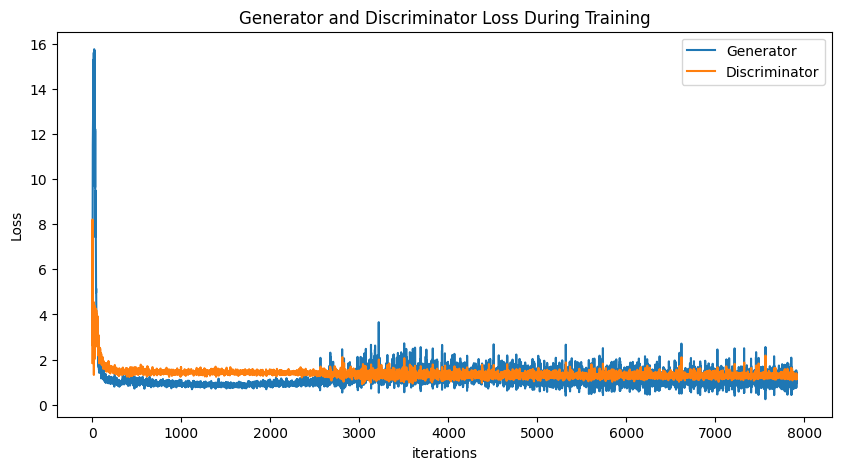

In [ ]:
def plot_losses(G_losses, D_losses):
    """
    Plots the losses for the Generator and Discriminator during training.

    This function performs the following steps:

    1. Creates a new figure with a specified size i.e, (10, 5).
    2. Sets the title of the plot.
    3. Plots the Generator losses as a line graph.
    4. Plots the Discriminator losses as a line graph.
    5. Labels the x-axis as "iterations".
    6. Labels the y-axis as "Loss".
    7. Adds a legend to the plot.
    8. Displays the plot.

    Parameters:
    G_losses (list of floats): A list of the Generator's losses, with each loss corresponding to an iteration of training.
    D_losses (list of floats): A list of the Discriminator's losses, with each loss corresponding to an iteration of training.
    """
    # Step 1: Create a new figure with specified size
    plt.figure(figsize=(10,5))
    # Step 2: Set the title of the plot
    plt.title("Generator and Discriminator Loss During Training")
    # Step 3: Plot the Generator losses
    plt.plot(G_losses,label="Generator")
    # Step 4: Plot the Discriminator losses
    plt.plot(D_losses,label="Discriminator")
    # Step 5: Label the x-axis
    plt.xlabel("iterations")
    # Step 6: Label the y-axis
    plt.ylabel("Loss")
    # Step 7: Add a legend
    plt.legend()
    # Step 8: Display the plot
    plt.show()

plot_losses(G_losses, D_losses)



### Visualizing Real and Generated Images

This function takes in a DataLoader object, a device specifier, and a list of images generated by the GAN. It then plots and displays a side-by-side comparison of real images from the dataset and the corresponding synthetic images generated by the trained Generator. This visual comparison assists in evaluating the performance of the trained GAN.



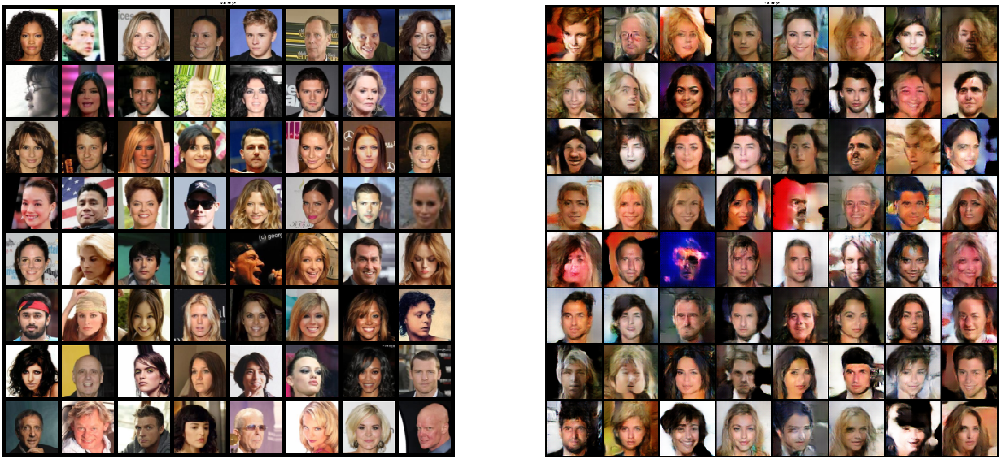

In [ ]:
def visualize_images(dataloader, device, img_list):
    """
    This function grabs a batch of real images from the dataloader and plots both the real and fake images.
    The real images are taken directly from the dataloader, whereas the fake images are taken from the last
    epoch of the generated image list.

    Parameters:
    -----------
    dataloader : DataLoader object
        The DataLoader object that provides batches of real images.
    device : string
        The device (cpu or gpu) where the images will be processed.
    img_list : list
        List of images from the last epoch of a generator in a GAN.

    Returns:
    --------
    None

    Example:
    --------
    >>> visualize_images(dataloader, 'cpu', img_list)
    """
    # Grab a batch of real images from the dataloader
    real_batch = next(iter(dataloader))

    # Plot the real images
    plt.figure(figsize=(80,80))
    plt.subplot(1,2,1)
    plt.axis("off")
    plt.title("Real Images")
    plt.imshow(np.transpose(vutils.make_grid(real_batch[0].to(device)[:64], padding=5, normalize=True).cpu(),(1,2,0)))

    # Plot the fake images from the last epoch
    plt.subplot(1,2,2)
    plt.axis("off")
    plt.title("Fake Images")
    plt.imshow(np.transpose(img_list[-1],(1,2,0)))
    plt.show()

visualize_images(dataloader, device, img_list)

### Animation of GAN Training Progress

This block of code creates an animation that shows the progression of images generated by the GAN over the course of training. Each frame in the animation corresponds to the output of the generator at different points in the training process. This provides a visual way to understand how the generator's performance has improved over time.




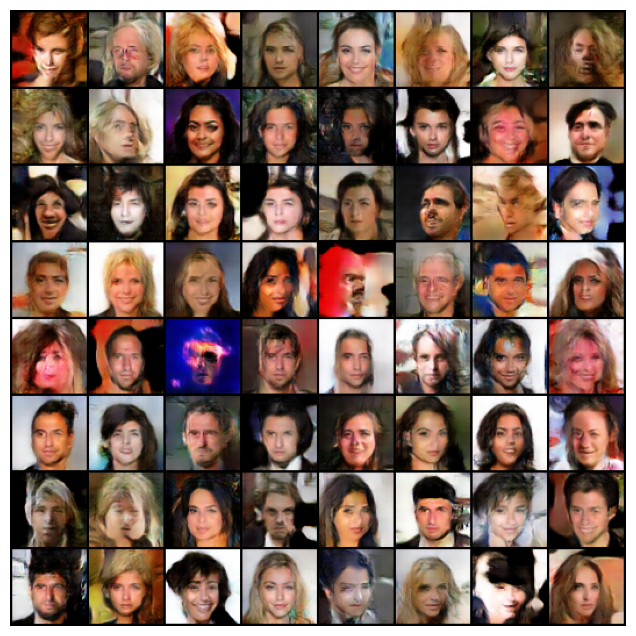

In [ ]:
#%%capture
fig = plt.figure(figsize=(8,8))
plt.axis("off")
ims = [[plt.imshow(np.transpose(i,(1,2,0)), animated=True)] for i in img_list]
ani = animation.ArtistAnimation(fig, ims, interval=1000, repeat_delay=1000, blit=True)

HTML(ani.to_jshtml())

### Exercises

1. Experimentation with Epochs:
Investigate the effect of increasing the number of training epochs on the quality of the generated images. Observe if extending the training duration allows the GAN to generate more realistic images.

2. MSE Evaluation:
Compute the Mean Squared Error (MSE) between the real and generated images for various training epochs. Analyze if an increase in training epochs correlates with a decrease in MSE, indicating the generator is creating images more similar to the real ones.

3. Architecture Optimization:
Explore different GAN architectures, potentially with varied layer designs or activation functions. Evaluate if alternative architectures produce superior results in fewer epochs compared to the current model, hence offering a more efficient training process.